# MNIST Fashion GAN
## Miniproject 8 - by Dimitry Mindlin & Thorben Markmann


In [1]:
import os
import tensorflow as tf
tf.get_logger().setLevel('ERROR')
import tensorflow_docs.vis.embed as embed
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import time
from IPython import display

In [2]:
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


### Generator Model Definition

In [3]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 28, 28, 1)

    return model

generator = make_generator_model()

### Discriminator Model Definition

In [4]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

discriminator = make_discriminator_model()

### Define loss functions and optimizers for both models.

In [5]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss, fake_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

## MNIST Fashion Dataset

- The MNIST Fashion Dataset is a drop-in replacement for the original MNIST dataset by Zalando Research
    - same number of training and testing images
    - same image size and type: 28x28, grayscale
    - 10 classes: T-shirt/top, Trouser, Pullover, Dress, Coat, Sandal, Shirt, Sneaker, Bag, Ankle boot
- Motivation: 
    1. MNIST is too easy (CNNs can achieve 99.7% accuracy on MNIST)
    2. MNIST is overused
    3. MNIST cannot represent modern CV tasks

In [6]:
BUFFER_SIZE = 60000
BATCH_SIZE = 256

(train_images, train_labels), (_, _) = tf.keras.datasets.fashion_mnist.load_data()
# Restructure Images and split into batches
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
train_images = (train_images - 127.5) / 127.5 # Normalize the images to [-1, 1]
DATASET_SIZE = len(train_images)

# Batch and shuffle the data
mnist_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

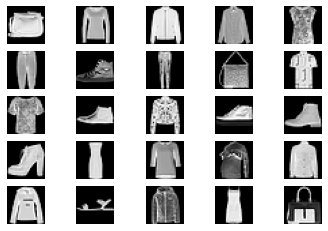

In [7]:
mnist_examples = list(mnist_dataset.unbatch().take(25).as_numpy_iterator())

for i in range(25):
    # define subplot
    plt.subplot(5, 5, 1 + i)
    # turn off axis
    plt.axis('off')
    # plot raw pixel data
    plt.imshow(mnist_examples[i], cmap='gray')
plt.show()

### Define the training loop

In [8]:
@tf.function
def train_step(images):
    # Train discriminator first for more steps
    for i in range(DISC_EXTRA_STEPS):
        with tf.GradientTape() as disc_tape:
            noise = tf.random.normal([BATCH_SIZE, noise_dim])
            generated_images = generator(noise, training=True)
            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)
            
            disc_real_loss, disc_fake_loss = discriminator_loss(real_output, fake_output)
            disc_loss = disc_real_loss + disc_fake_loss
            
            gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
            discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
            
            if i == (DISC_EXTRA_STEPS - 1):
                # Calculate accuracy
                acc_real = 0
                acc_fake = 0
                for output in real_output:
                    if output > 0:
                        acc_real += 1

                for output in fake_output:
                    if output < 0:
                        acc_fake += 1

                acc_real = acc_real / len(real_output)
                acc_fake = acc_fake /  len(fake_output)
    
    # train generator
    with tf.GradientTape() as gen_tape:
        noise = tf.random.normal([BATCH_SIZE, noise_dim])
        # Generate fake images using the generator
        generated_images = generator(noise, training=True)
        # Get the discriminator logits for fake images
        fake_output = discriminator(generated_images, training=True)
        # Calculate the generator loss
        gen_loss = generator_loss(fake_output)
        
        gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    
    return gen_loss, disc_real_loss, disc_fake_loss, acc_real, acc_fake

In [ ]:
from helper import generate_and_save_images, get_empty_performance, add_to_performance, get_perf_mean, get_empty_summary, add_to_summary 

In [9]:
def train(dataset, epochs, seed, output_dir='out'):
    summary = get_empty_summary(epochs) # Performance summary with various metrics
    
    for epoch in range(epochs):
        start = time.time()
        performance = get_empty_performance()
        count = 0
        for image_batch in dataset:
            # Train step
            gen_loss, disc_real_loss, disc_fake_loss, acc_real, acc_fake = train_step(image_batch)
            
            # Inception Score
            noise = tf.random.normal([BATCH_SIZE, noise_dim])
            generated_data = generator.predict(noise)
            inc_score = float(get_inception_score(generated_data))
            
            # Update performance summary
            add_to_performance(performance, gen_loss, disc_real_loss, disc_fake_loss, acc_real, acc_fake, inc_score)
            count += 1
            
        add_to_summary(summary, get_perf_mean(performance, count))
            
        # Produce images for the GIF as we go
        display.clear_output(wait=True)
        generate_and_save_images(generator, epoch + 1, seed, output_dir)

        duration = time.time()-start
        print('Epoch {}/{} - {}s ETA: {}s - gen_loss: {} - disc_loss: {}'.format(epoch+1, epochs, round(duration), 
                                                                                 round(duration*(epochs-epoch-1)), 
                                                                                 round(float(performance["gen_loss"]), 4), 
                                                                                 round(float(performance["disc_real_loss"]), 4), 
                                                                                 round(float(performance["disc_fake_loss"]), 4)))
    return summary

## GAN training in action

In [10]:
EPOCHS = 200
DISC_EXTRA_STEPS = 1
noise_dim = 100
num_examples_to_generate = 16
# reuse this seed overtime (so it's easier to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

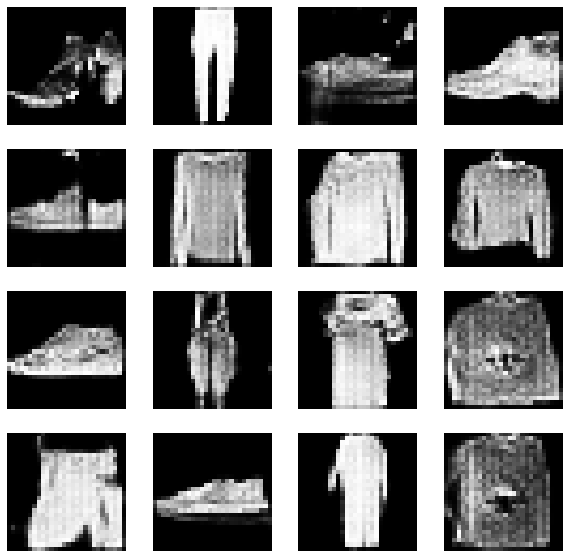

Epoch 200/200 - 23s ETA: 0s - gen_loss: 1.003 - disc_loss: 0.6135


In [11]:
performance_summary = train(mnist_dataset, EPOCHS, seed, 'fashion')

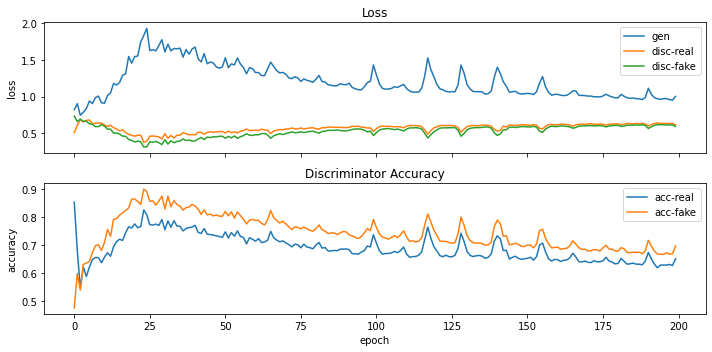

In [12]:
from helper import plot_loss_acc_fashion
plot_loss_acc_fashion(performance_summary, output_name=f'fashion_k-{DISC_EXTRA_STEPS}')


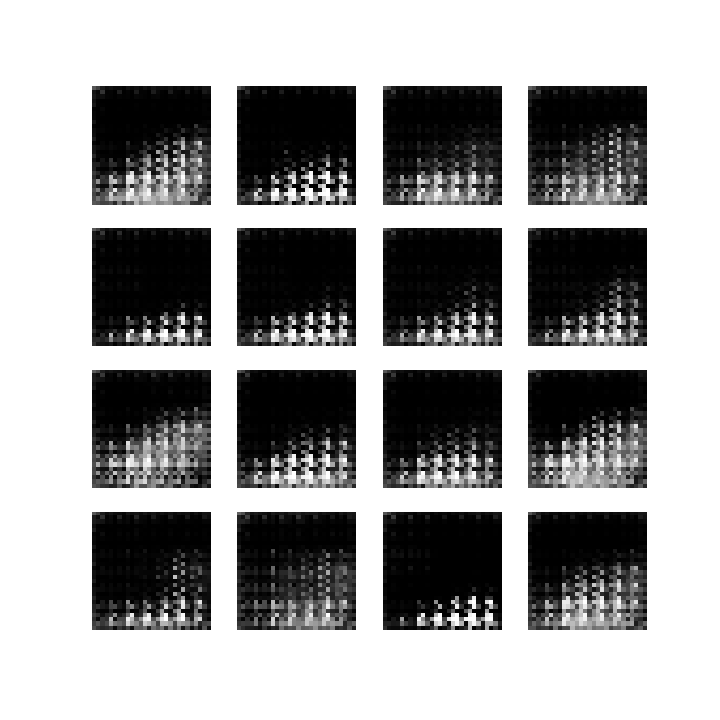

In [13]:
from helper import create_gif
create_gif('fashion')
embed.embed_file('fashion/dcgan.gif')

## Exploring the latent space

In [ ]:
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples, n_classes=10):
    # generate points in the latent space
    x_input = np.random.randn(latent_dim * n_samples)
    # reshape into a batch of inputs for the network
    z_input = x_input.reshape(n_samples, latent_dim)
    return z_input

latent_points = generate_latent_points(noise_dim, 10)
print(f"Created {len(latent_points)} latent points")

In [15]:
# uniform interpolation between two points in latent space
def interpolate_points(p1, p2, n_steps=10):
    # interpolate ratios between the points
    ratios = np.linspace(0, 1, num=n_steps)
    # linear interpolate vectors
    vectors = list()
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vectors.append(v)
    return np.asarray(vectors)

interpolated_point = interpolate_points(latent_points[0], latent_points[1])

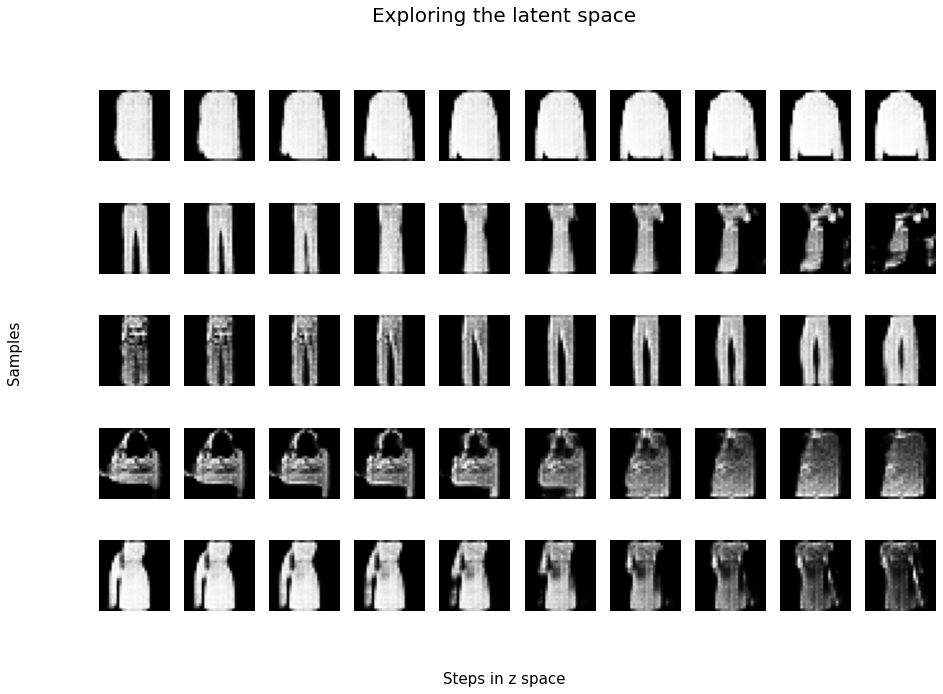

In [16]:
from helper import plot_latent_space_steps
n = 5 # number of samples
pts = generate_latent_points(noise_dim, n*2)
# interpolate pairs
results = None
for i in range(0, n*2, 2):
    # interpolate points in latent space
    interpolated = interpolate_points(pts[i], pts[i+1])
    # generate images
    X = generator.predict(interpolated)
    # scale from [-1,1] to [0,1]
    X = (X + 1) / 2.0
    if results is None:
        results = X
    else:
        results = np.vstack((results, X))
# plot the result
plot_latent_space_steps(results, n)